Silent Cities Dataset - Unsupervised learning 
--

In [1]:
import pandas as pd
import numpy as np
from audioset_tagging_cnn.config import labels
import datetime
from matplotlib import pyplot as plt 
%matplotlib inline

Read dataframe

In [2]:
Df = pd.read_pickle('20200402_analysis.xz')
allfiles = np.stack(Df['file'])

Df['id'] = ([cid[54:58] for cid in allfiles]) ### this is highly specific to my computer nfarrugi


Export for collaborators


In [6]:
Df_export = Df[['id','datetime','date','time','label','ndsi']]
Df_export.to_csv('silentcities_export_20200402.csv')

Separate by subjects

/home/nfarrugi/miniconda3/lib/python3.7/site-packages/numba/typed_passes.py:293: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  state.func_ir.loc))


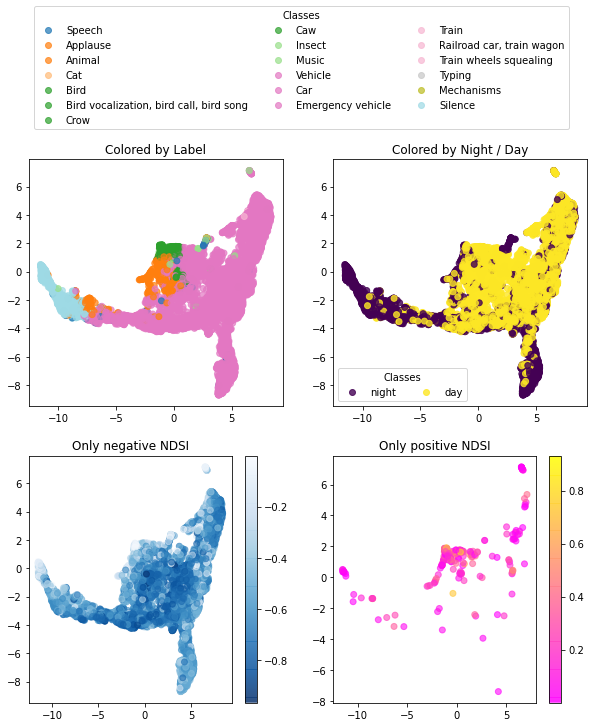

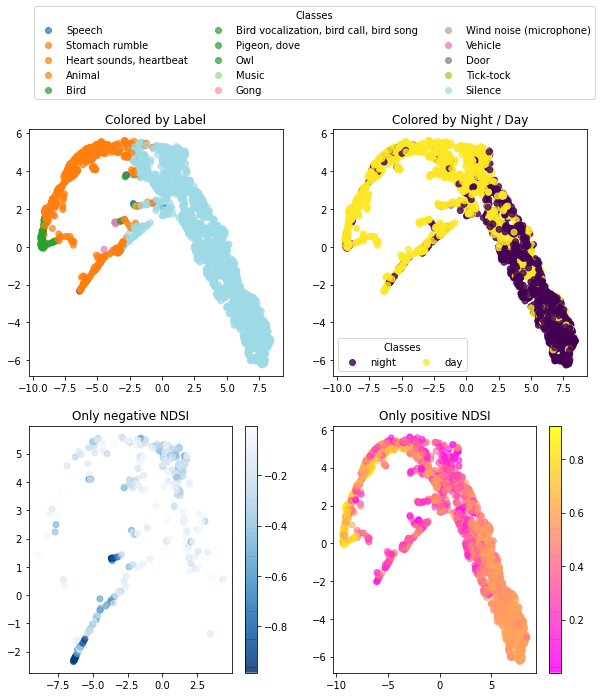

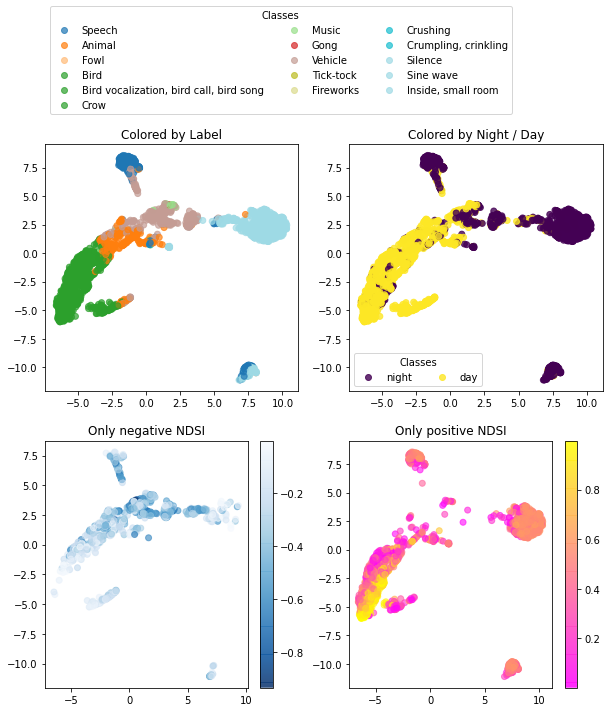

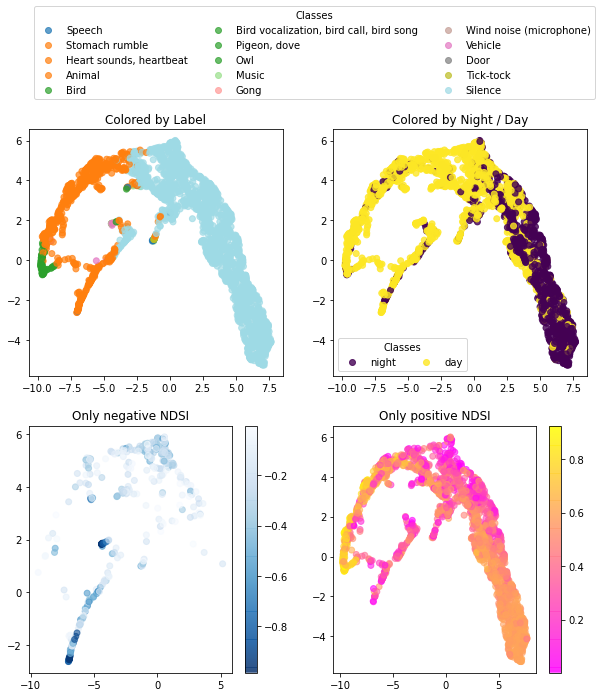

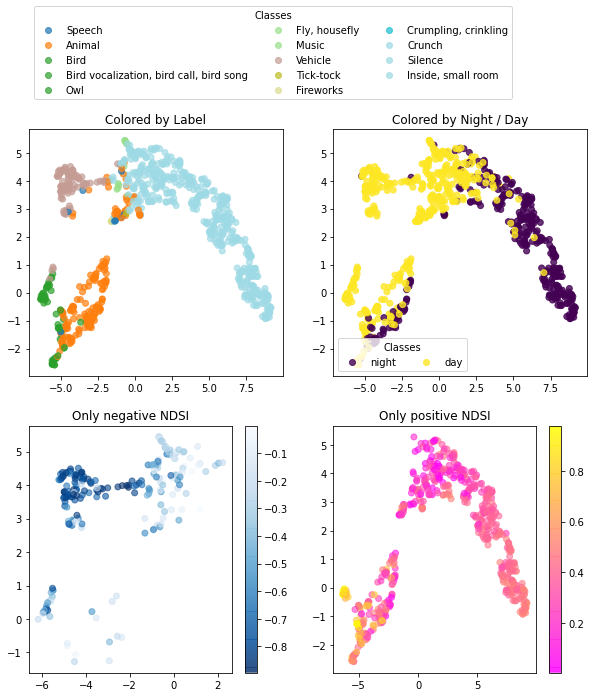

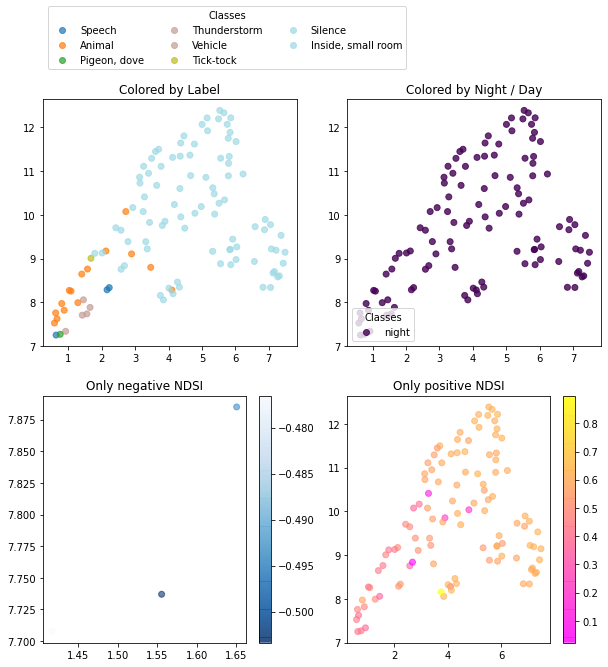

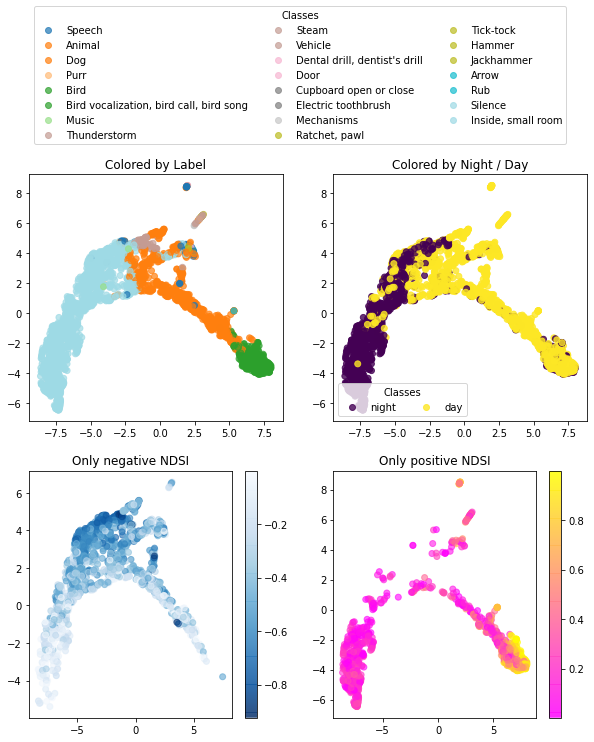

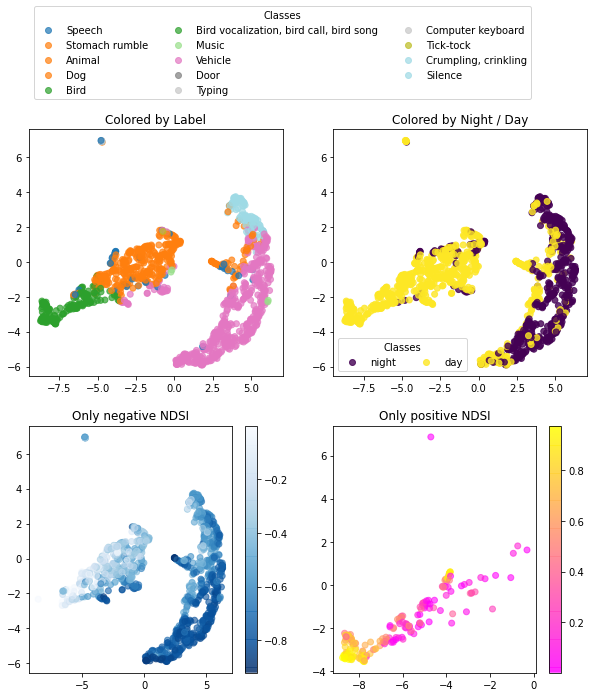

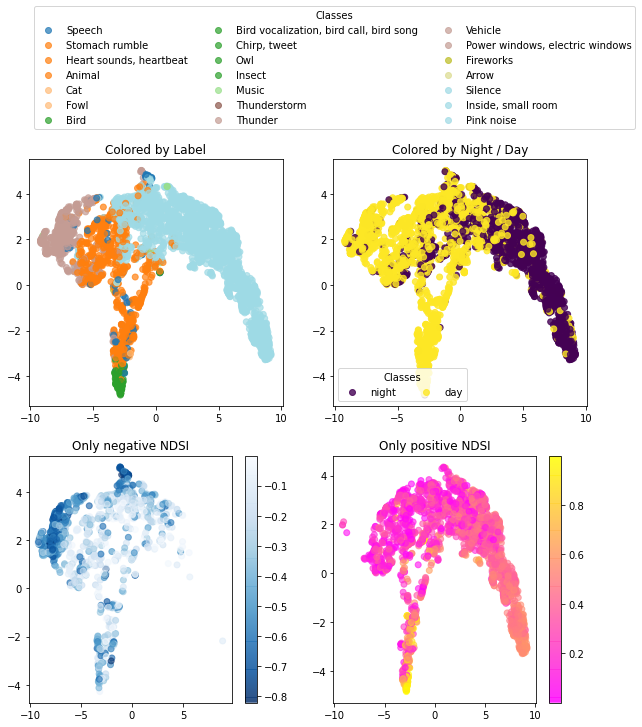

In [13]:
from analysis import figure_embedding, extract_subject

for curid in np.unique(Df['id']):
    curDf = extract_subject(Df,curid)
    fig = figure_embedding(curDf)
    fig.savefig("{}_embed.png".format(curid),bbox_inches='tight')

Gather the probas and find the categories for which the maximum through the night is more than a certain proba threshold

In [75]:
from analysis import keep_array_thresh

In [76]:
ind_labels,max_labels =keep_array_thresh(allprobas,threshold = 0.1)
kept_labels = [labels[int(i)] for i in ind_labels]

Theses are the labels that have a probability of more than 10% at least once in all the recordings

In [78]:
nbobs = len(Df.file)

In [79]:
filelist = Df.file

for i,lab in enumerate(kept_labels):
    print(i,lab,max_labels[i],ind_labels[i])

0 Speech [0.58250964] [0]
1 Snoring [0.13696557] [43]
2 Stomach rumble [0.2263167] [57]
3 Finger snapping [0.16870728] [62]
4 Clapping [0.10343278] [63]
5 Cheering [0.280217] [66]
6 Applause [0.5071081] [67]
7 Crowd [0.21687128] [69]
8 Animal [0.43811512] [72]
9 Domestic animals, pets [0.24104851] [73]
10 Cat [0.45570964] [81]
11 Purr [0.30539948] [82]
12 Meow [0.34467736] [83]
13 Caterwaul [0.10771244] [85]
14 Livestock, farm animals, working animals [0.13110282] [86]
15 Cattle, bovinae [0.14390077] [90]
16 Moo [0.12978163] [91]
17 Fowl [0.13313484] [98]
18 Duck [0.14147012] [104]
19 Quack [0.13482833] [105]
20 Wild animals [0.10383789] [108]
21 Bird [0.48089692] [111]
22 Bird vocalization, bird call, bird song [0.3764497] [112]
23 Chirp, tweet [0.3255813] [113]
24 Squawk [0.11923118] [114]
25 Pigeon, dove [0.12272942] [115]
26 Crow [0.7058302] [117]
27 Caw [0.6911305] [118]
28 Owl [0.17650957] [119]
29 Insect [0.22527915] [126]
30 Cricket [0.18838178] [127]
31 Fly, housefly [0.105006

In [22]:
file = inverse_search(allprobas,kept_labels,'Aircraft',Df)
print(file)
ipd.Audio(file)

TypeError: only size-1 arrays can be converted to Python scalars

Now manually filter this list to visualize only a few of them 

In [11]:
subset = [0,1,6,13,18,20,27]
print([kept_labels[categ] for categ in subset])

['Speech', 'Snoring', 'Dog', 'Bird', 'Cricket', 'Vehicle', 'Door']


In [12]:
ind_labels_final = [ind_labels[categ] for categ in subset]
kept_labels_final = [kept_labels[categ] for categ in subset]

In [13]:
allprobas_kept = allprobas[:,ind_labels_final].squeeze()

Finally prepare a simple visualisation.

<Figure size 1440x720 with 0 Axes>

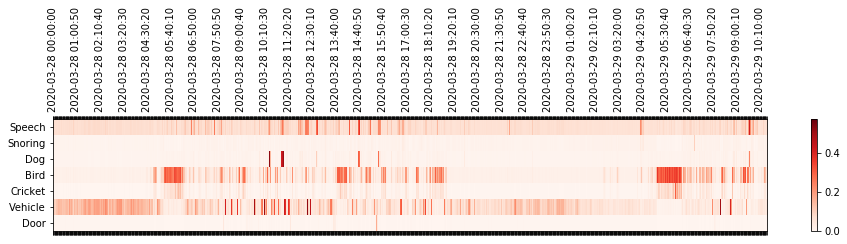

In [14]:
nbannot = 30

skiptime = nbobs//nbannot ### this is necessary to annotate the x axis, change this value to print more or less date / time labels

timelabels = [''] * len(Df.datetime)

origtimes = list(Df.datetime)

for i in np.arange(0,len(origtimes),skiptime):
    timelabels[i] = origtimes[i]
    

plt.figure(figsize=(20,10))
plt.matshow(allprobas_kept.T,vmin=0,aspect='auto',cmap=plt.cm.Reds)
plt.yticks(ticks = range(len(kept_labels_final)),labels=kept_labels_final)
plt.xticks(ticks = range(len(timelabels)),labels = timelabels,rotation=90)
plt.colorbar()
plt.savefig('silentcity.png',dpi=300,bbox_inches='tight')

In [17]:
import IPython.display as ipd

from analysis import inverse_search

In [18]:
ipd.Audio(inverse_search(allprobas_kept,kept_labels_final,'Owl',Df))

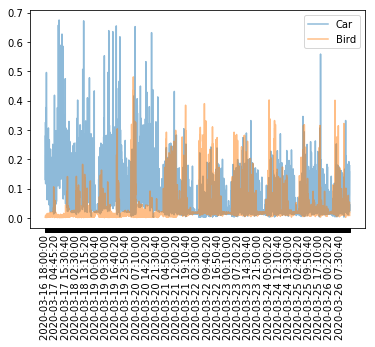

In [25]:
nbannot = 30

skiptime = nbobs//nbannot ### this is necessary to annotate the x axis, change this value to print more or less date / time labels

timelabels = [''] * len(Df.datetime)

origtimes = list(Df.datetime)

for i in np.arange(0,len(origtimes),skiptime):
    timelabels[i] = origtimes[i]
    

plt.plot(allprobas_kept[:,6],alpha=0.5)
plt.plot(allprobas_kept[:,2],alpha=0.5)
plt.xticks(ticks = range(len(timelabels)),labels = timelabels,rotation=90)
plt.legend(['Car','Bird'])
plt.savefig('silentcity2.png',dpi=300,bbox_inches='tight')
plt.show()

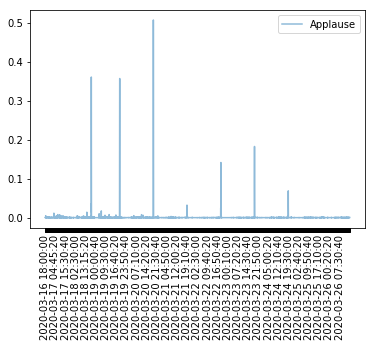

In [26]:

nbannot = 30

skiptime = nbobs//nbannot ### this is necessary to annotate the x axis, change this value to print more or less date / time labels

timelabels = [''] * len(Df.datetime)

origtimes = list(Df.datetime)

for i in np.arange(0,len(origtimes),skiptime):
    timelabels[i] = origtimes[i]
    
plt.plot(allprobas_kept[:,1],alpha=0.5)
plt.xticks(ticks = range(len(timelabels)),labels = timelabels,rotation=90)
plt.legend(['Applause'])
plt.savefig('silentcity_applause.png',dpi=300,bbox_inches='tight')
plt.show()


In [23]:
ambulance = allprobas_kept[:,6]
bird = allprobas_kept[:,1]
music = allprobas_kept[:,3]
vehicle= allprobas_kept[:,2]

In [ ]:
def inverse_search_max()

In [21]:
ind_ambulancetime = np.argmax(ambulance)
ind_birdtime = np.argmax(bird)



In [15]:
files = list(Df.file)

In [16]:
len(files)

1452

In [18]:
files[ind_ambulancetime]

'/home/nfarrugi/Documents/data/SilentCities/osfstorage-archive/5E712C40.WAV'

In [19]:
import IPython.display as ipd
ipd.Audio(files[ind_ambulancetime])

In [22]:

ipd.Audio(files[ind_birdtime])

In [24]:
files[ind_birdtime]

'/home/nfarrugi/Documents/data/SilentCities/osfstorage-archive/5E71ED9C.WAV'